In [1]:
import tensorflow as tf
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import os
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential

In [8]:
ls

In [2]:
# Loading and preprocessing the image
dataset = '/kaggle/input/gan-dataset'
datagen = ImageDataGenerator(rescale=1./255)
train_dataset = datagen.flow_from_directory(
    dataset,
    target_size=(64, 64),
    batch_size=8,
    class_mode=None,
)


Found 5734 images belonging to 1 classes.


In [4]:
# Generator model
def build_generator():
    model = Sequential([
        layers.Dense(32, activation="relu", input_shape=(100,)),
        layers.Dense(128, activation="relu"),
        layers.Dense(256, activation="relu"),
        layers.Dense(64*64*3, activation="tanh"),
        layers.Reshape((64,64, 3))  # Reshape to image shape
    ])
    return model

# Define the discriminator model
def build_discriminator():
    model = Sequential([
        layers.Flatten(input_shape=(64,64, 3)),  # Flatten the image
        layers.Dense(256, activation="relu"),
        layers.Dense(128, activation="relu"),
        layers.Dense(1, activation="sigmoid")  # Output a probability (real or fake)
    ])
    return model

# Define the GAN model (generator + discriminator)
def build_gan(generator, discriminator):
    discriminator.trainable = False  # Freeze the discriminator during GAN training
    model = Sequential([generator, discriminator])
    return model



In [7]:
# Compile discriminator
discriminator = build_discriminator()
discriminator.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Compile GAN
generator = build_generator()
gan = build_gan(generator, discriminator)
gan.compile(optimizer='adam', loss='binary_crossentropy')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/backend/tensorflow/trainer.py:75: UserWarning: The model does not have any trainable weights.
  warnings.warn("The model does not have any trainable weights.")


Epoch 1/10, D Loss Real: 0.9850597381591797, D Loss Fake: 0.8399072885513306, G Loss: [array(0.8399073, dtype=float32), array(0.8399073, dtype=float32), array(0.25, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 1/10, D Loss Real: 0.8586359024047852, D Loss Fake: 1.0891587734222412, G Loss: [array(1.0891588, dtype=float32), array(1.0891588, dtype=float32), array(0.125, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 1/10, D Loss Real: 1.0503658056259155, D Loss Fake: 1.5030092000961304, G Loss: [array(1.5030092, dtype=float32), array(1.5030092, dtype=float32), array(0.10416666, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Epoch 1/10, D Loss Real: 1.4137779474258423, D Loss Fake: 1.8874634504318237, G Loss: [array(1.8874635, dtype=float32), array(1.8874635, dtype=float32), array(0.078125, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Epoch 1/10, D Loss Real: 1.7867094278335571, D Loss Fake: 2.503462076187134, G Loss: [array(2.503462, dtype=float

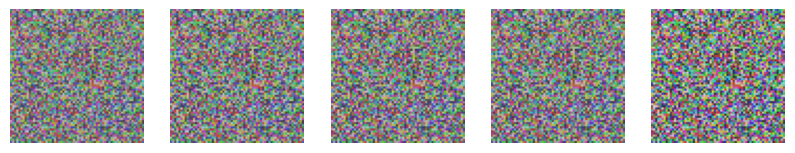

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.763038635253906, D Loss Fake: 16.772321701049805, G Loss: [array(16.772322, dtype=float32), array(16.772322, dtype=float32), array(0.04326253, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


<Figure size 640x480 with 0 Axes>

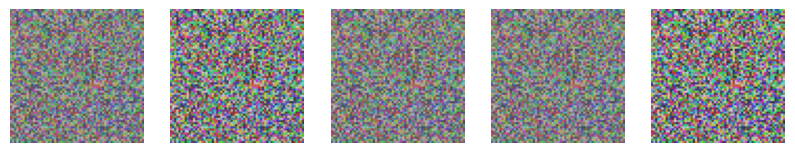

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.761316299438477, D Loss Fake: 16.774024963378906, G Loss: [array(16.774025, dtype=float32), array(16.774025, dtype=float32), array(0.04328929, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


<Figure size 640x480 with 0 Axes>

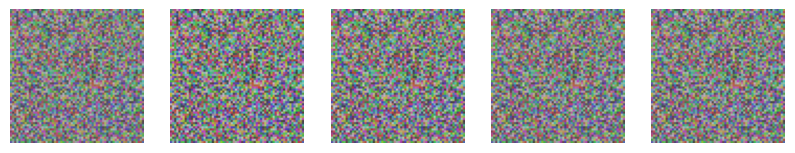

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.762914657592773, D Loss Fake: 16.774425506591797, G Loss: [array(16.774426, dtype=float32), array(16.774426, dtype=float32), array(0.04348958, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


<Figure size 640x480 with 0 Axes>

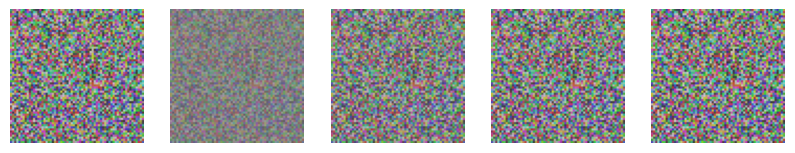

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.763446807861328, D Loss Fake: 16.77383041381836, G Loss: [array(16.77383, dtype=float32), array(16.77383, dtype=float32), array(0.04342927, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

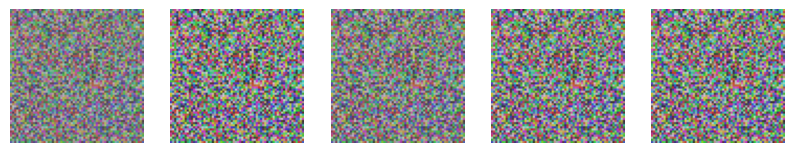

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.76288604736328, D Loss Fake: 16.773319244384766, G Loss: [array(16.77332, dtype=float32), array(16.77332, dtype=float32), array(0.04336911, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

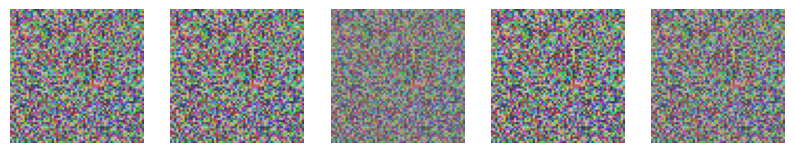

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.762340545654297, D Loss Fake: 16.771743774414062, G Loss: [array(16.771744, dtype=float32), array(16.771744, dtype=float32), array(0.04330913, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

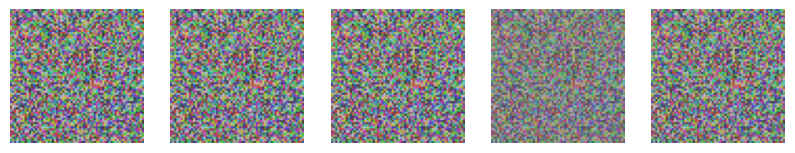

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Epoch 2/10, D Loss Real: 16.76081085205078, D Loss Fake: 16.77217674255371, G Loss: [array(16.772177, dtype=float32), array(16.772177, dtype=float32), array(0.04333564, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

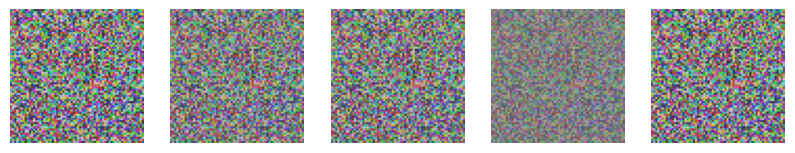

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.761322021484375, D Loss Fake: 16.77410888671875, G Loss: [array(16.774109, dtype=float32), array(16.774109, dtype=float32), array(0.04327586, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

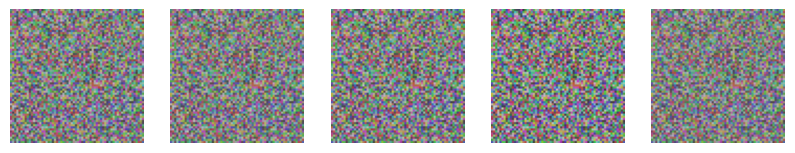

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Epoch 2/10, D Loss Real: 16.763227462768555, D Loss Fake: 16.77253532409668, G Loss: [array(16.772535, dtype=float32), array(16.772535, dtype=float32), array(0.04321625, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

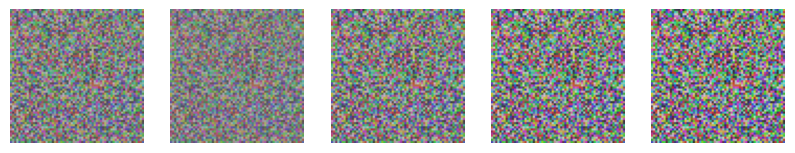

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Epoch 2/10, D Loss Real: 16.761579513549805, D Loss Fake: 16.773616790771484, G Loss: [array(16.773617, dtype=float32), array(16.773617, dtype=float32), array(0.04324278, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

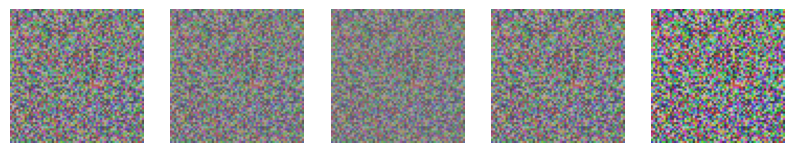

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.762704849243164, D Loss Fake: 16.772676467895508, G Loss: [array(16.772676, dtype=float32), array(16.772676, dtype=float32), array(0.04326923, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

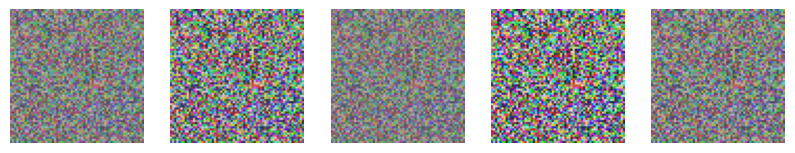

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.761775970458984, D Loss Fake: 16.7728214263916, G Loss: [array(16.772821, dtype=float32), array(16.772821, dtype=float32), array(0.04329561, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

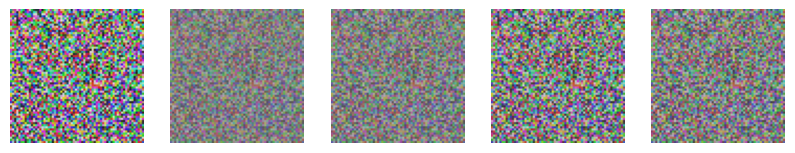

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.761838912963867, D Loss Fake: 16.773218154907227, G Loss: [array(16.773218, dtype=float32), array(16.773218, dtype=float32), array(0.04340753, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

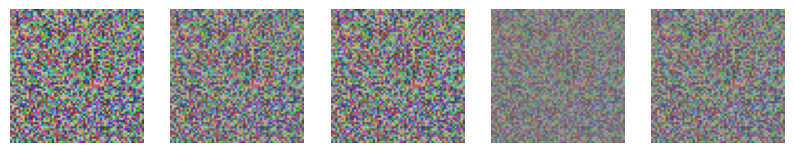

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.762359619140625, D Loss Fake: 16.7735538482666, G Loss: [array(16.773554, dtype=float32), array(16.773554, dtype=float32), array(0.04351915, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

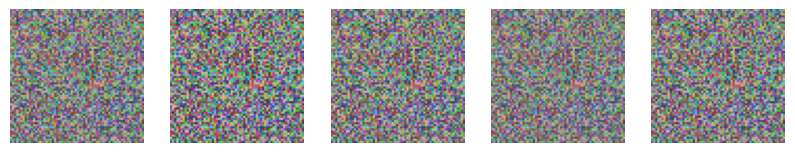

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.762784957885742, D Loss Fake: 16.772018432617188, G Loss: [array(16.772018, dtype=float32), array(16.772018, dtype=float32), array(0.04354508, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

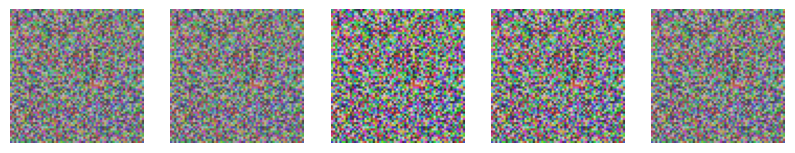

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Epoch 2/10, D Loss Real: 16.76124382019043, D Loss Fake: 16.77483558654785, G Loss: [array(16.774836, dtype=float32), array(16.774836, dtype=float32), array(0.04348568, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


<Figure size 640x480 with 0 Axes>

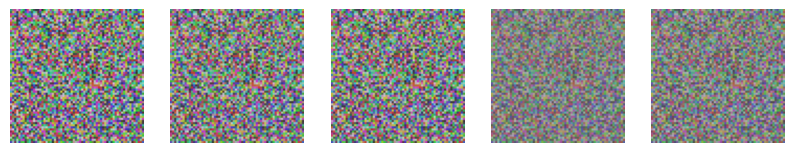

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Epoch 2/10, D Loss Real: 16.763992309570312, D Loss Fake: 16.77618408203125, G Loss: [array(16.776184, dtype=float32), array(16.776184, dtype=float32), array(0.04342643, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

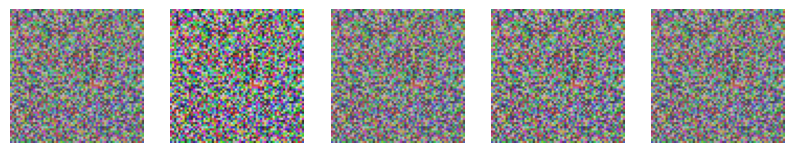

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.765390396118164, D Loss Fake: 16.77989959716797, G Loss: [array(16.7799, dtype=float32), array(16.7799, dtype=float32), array(0.04336735, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

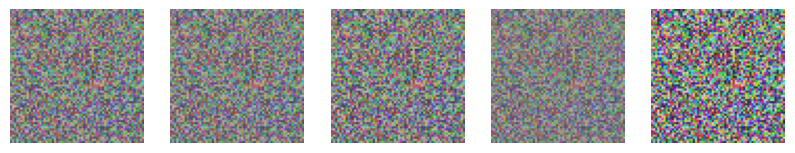

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.769119262695312, D Loss Fake: 16.780960083007812, G Loss: [array(16.78096, dtype=float32), array(16.78096, dtype=float32), array(0.04330843, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

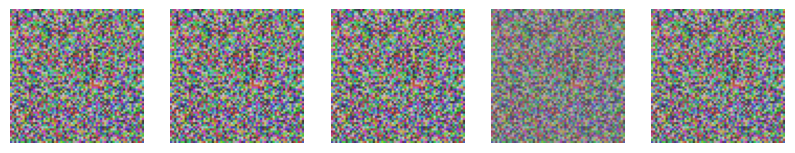

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.77010726928711, D Loss Fake: 16.7814998626709, G Loss: [array(16.7815, dtype=float32), array(16.7815, dtype=float32), array(0.04333447, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

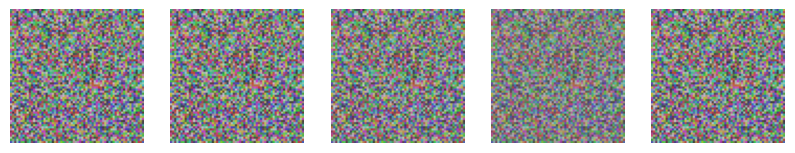

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.770671844482422, D Loss Fake: 16.78154945373535, G Loss: [array(16.78155, dtype=float32), array(16.78155, dtype=float32), array(0.04336043, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

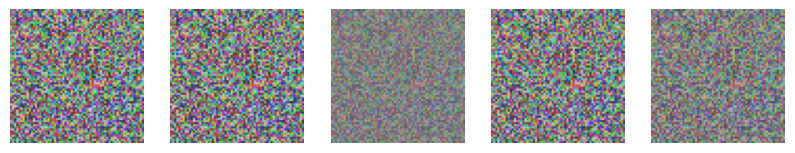

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.770845413208008, D Loss Fake: 16.78235626220703, G Loss: [array(16.782356, dtype=float32), array(16.782356, dtype=float32), array(0.04330176, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

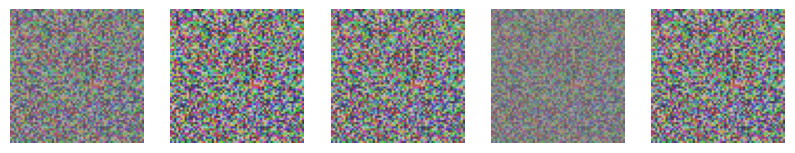

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.771692276000977, D Loss Fake: 16.782930374145508, G Loss: [array(16.78293, dtype=float32), array(16.78293, dtype=float32), array(0.0433277, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

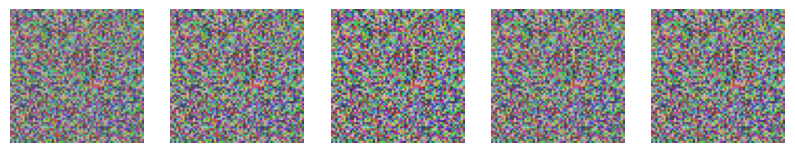

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.77220344543457, D Loss Fake: 16.782405853271484, G Loss: [array(16.782406, dtype=float32), array(16.782406, dtype=float32), array(0.04335358, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

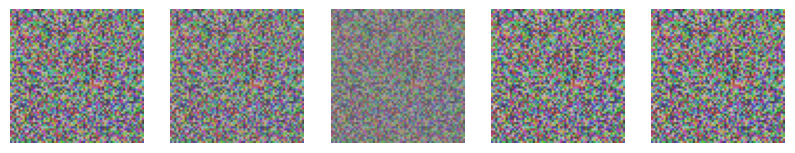

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.77178955078125, D Loss Fake: 16.782455444335938, G Loss: [array(16.782455, dtype=float32), array(16.782455, dtype=float32), array(0.04329515, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

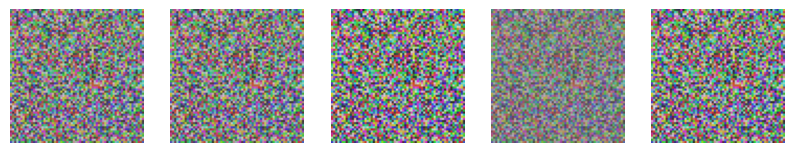

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.77190589904785, D Loss Fake: 16.782190322875977, G Loss: [array(16.78219, dtype=float32), array(16.78219, dtype=float32), array(0.04323688, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

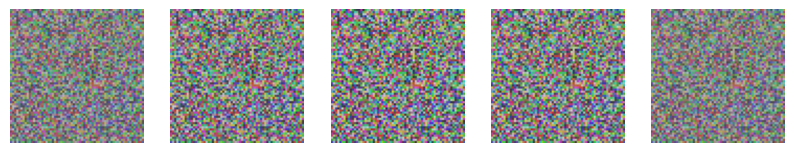

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.771528244018555, D Loss Fake: 16.781299591064453, G Loss: [array(16.7813, dtype=float32), array(16.7813, dtype=float32), array(0.04317876, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


<Figure size 640x480 with 0 Axes>

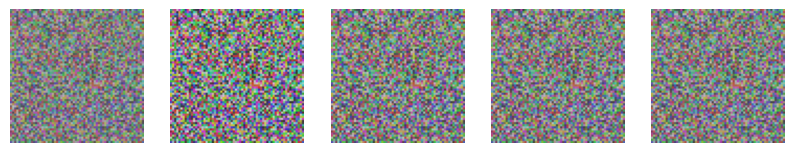

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Epoch 2/10, D Loss Real: 16.770652770996094, D Loss Fake: 16.782188415527344, G Loss: [array(16.782188, dtype=float32), array(16.782188, dtype=float32), array(0.04312081, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

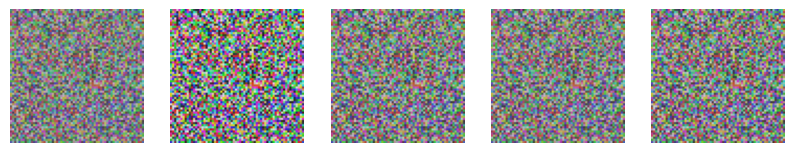

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.77151107788086, D Loss Fake: 16.78420639038086, G Loss: [array(16.784206, dtype=float32), array(16.784206, dtype=float32), array(0.04323056, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

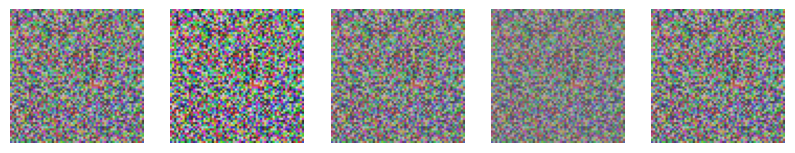

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.77359390258789, D Loss Fake: 16.78483772277832, G Loss: [array(16.784838, dtype=float32), array(16.784838, dtype=float32), array(0.04317269, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

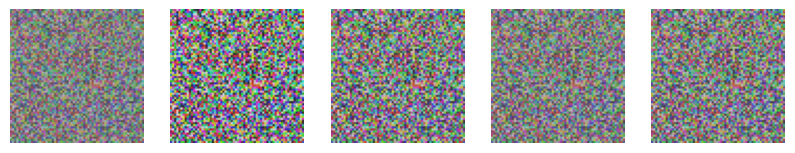

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.774261474609375, D Loss Fake: 16.78641700744629, G Loss: [array(16.786417, dtype=float32), array(16.786417, dtype=float32), array(0.04311498, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

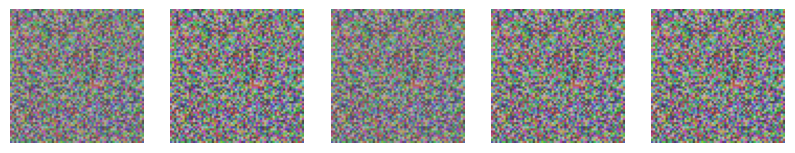

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.77577018737793, D Loss Fake: 16.78672981262207, G Loss: [array(16.78673, dtype=float32), array(16.78673, dtype=float32), array(0.0432243, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

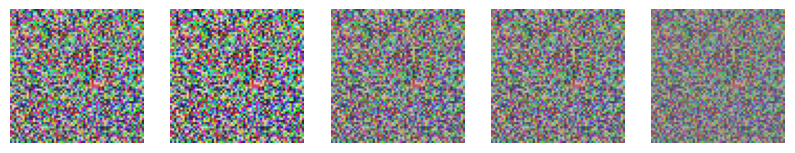

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.776134490966797, D Loss Fake: 16.789426803588867, G Loss: [array(16.789427, dtype=float32), array(16.789427, dtype=float32), array(0.04325, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

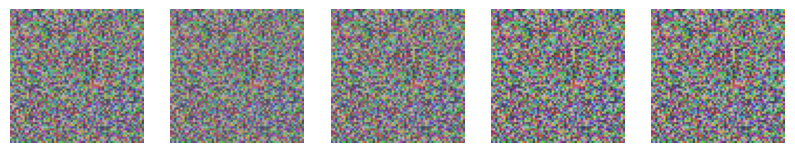

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Epoch 2/10, D Loss Real: 16.778820037841797, D Loss Fake: 16.789371490478516, G Loss: [array(16.789371, dtype=float32), array(16.789371, dtype=float32), array(0.04344208, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

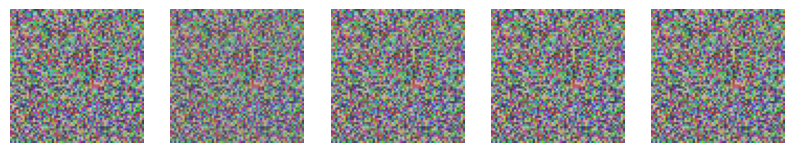

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.778837203979492, D Loss Fake: 16.79024887084961, G Loss: [array(16.790249, dtype=float32), array(16.790249, dtype=float32), array(0.04338431, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


<Figure size 640x480 with 0 Axes>

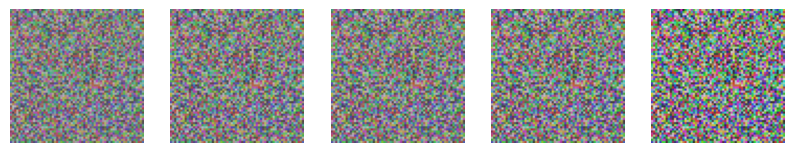

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Epoch 2/10, D Loss Real: 16.779733657836914, D Loss Fake: 16.791423797607422, G Loss: [array(16.791424, dtype=float32), array(16.791424, dtype=float32), array(0.0434927, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


<Figure size 640x480 with 0 Axes>

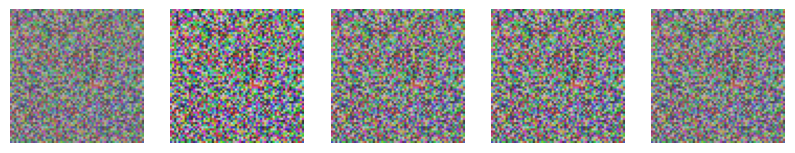

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Epoch 2/10, D Loss Real: 16.780902862548828, D Loss Fake: 16.793643951416016, G Loss: [array(16.793644, dtype=float32), array(16.793644, dtype=float32), array(0.04351791, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


<Figure size 640x480 with 0 Axes>

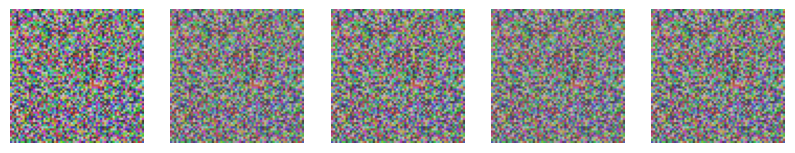

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.783077239990234, D Loss Fake: 16.793285369873047, G Loss: [array(16.793285, dtype=float32), array(16.793285, dtype=float32), array(0.04354305, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

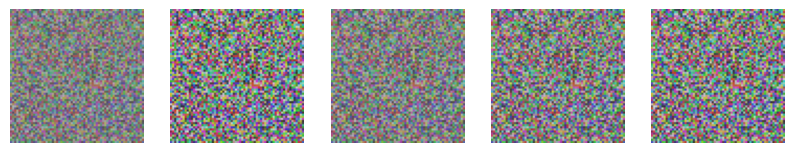

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.7828426361084, D Loss Fake: 16.793855667114258, G Loss: [array(16.793856, dtype=float32), array(16.793856, dtype=float32), array(0.04348545, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

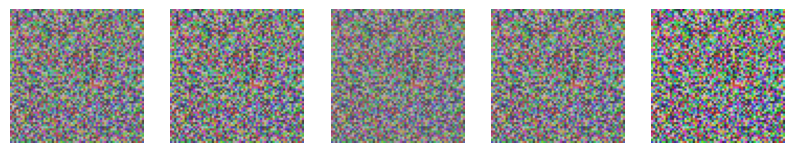

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.78334617614746, D Loss Fake: 16.79391098022461, G Loss: [array(16.793911, dtype=float32), array(16.793911, dtype=float32), array(0.04351057, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

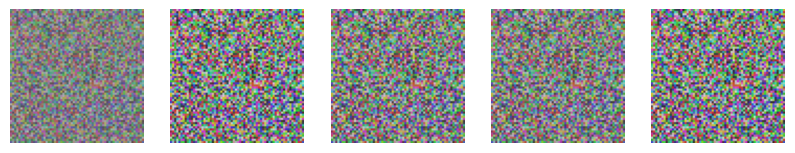

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.783428192138672, D Loss Fake: 16.79329490661621, G Loss: [array(16.793295, dtype=float32), array(16.793295, dtype=float32), array(0.04353562, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

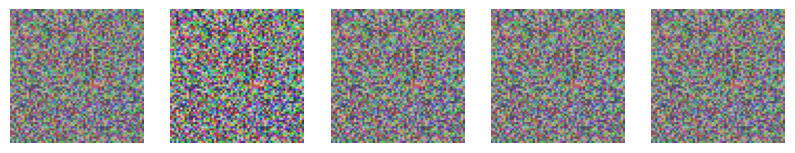

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.78278923034668, D Loss Fake: 16.79380989074707, G Loss: [array(16.79381, dtype=float32), array(16.79381, dtype=float32), array(0.04356061, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

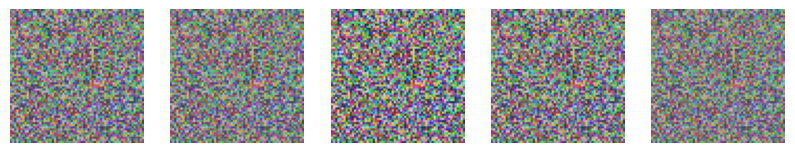

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Epoch 2/10, D Loss Real: 16.78339958190918, D Loss Fake: 16.793521881103516, G Loss: [array(16.793522, dtype=float32), array(16.793522, dtype=float32), array(0.04350329, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

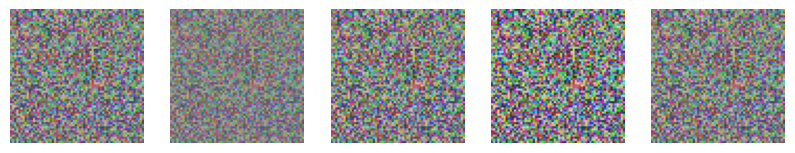

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.783079147338867, D Loss Fake: 16.792072296142578, G Loss: [array(16.792072, dtype=float32), array(16.792072, dtype=float32), array(0.04344612, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

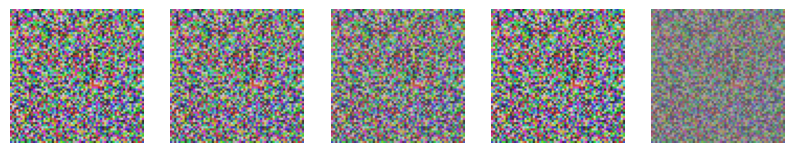

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.78166389465332, D Loss Fake: 16.79303741455078, G Loss: [array(16.793037, dtype=float32), array(16.793037, dtype=float32), array(0.04338911, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

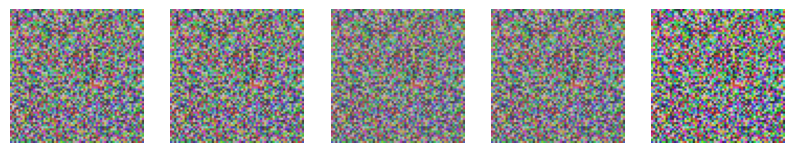

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.78261375427246, D Loss Fake: 16.7923641204834, G Loss: [array(16.792364, dtype=float32), array(16.792364, dtype=float32), array(0.04333224, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


<Figure size 640x480 with 0 Axes>

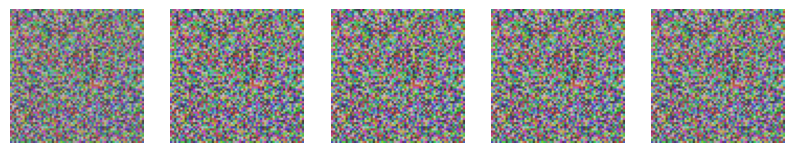

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Epoch 2/10, D Loss Real: 16.782001495361328, D Loss Fake: 16.78914451599121, G Loss: [array(16.789145, dtype=float32), array(16.789145, dtype=float32), array(0.04343913, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

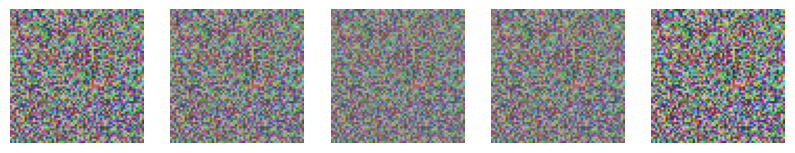

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.77867889404297, D Loss Fake: 16.788089752197266, G Loss: [array(16.78809, dtype=float32), array(16.78809, dtype=float32), array(0.04354575, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

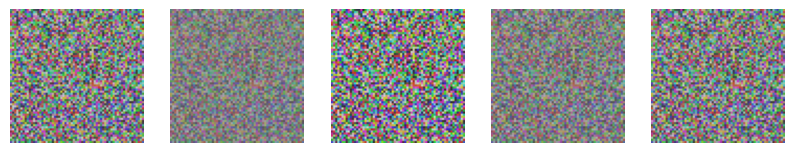

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.777727127075195, D Loss Fake: 16.786638259887695, G Loss: [array(16.786638, dtype=float32), array(16.786638, dtype=float32), array(0.0435705, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

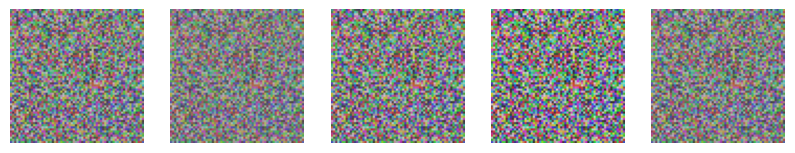

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.77630043029785, D Loss Fake: 16.785755157470703, G Loss: [array(16.785755, dtype=float32), array(16.785755, dtype=float32), array(0.04351369, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

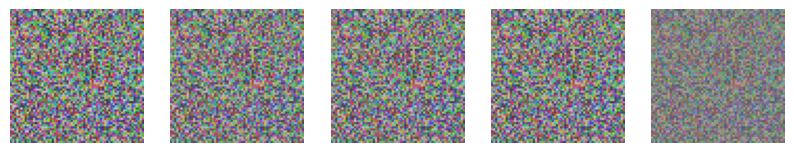

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.77547264099121, D Loss Fake: 16.787717819213867, G Loss: [array(16.787718, dtype=float32), array(16.787718, dtype=float32), array(0.04353841, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

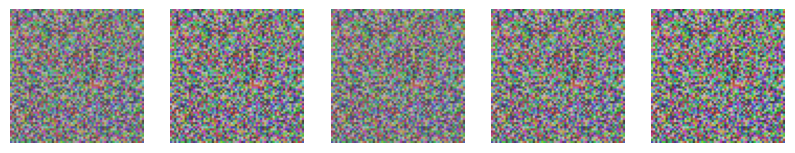

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Epoch 2/10, D Loss Real: 16.77735137939453, D Loss Fake: 16.787738800048828, G Loss: [array(16.787739, dtype=float32), array(16.787739, dtype=float32), array(0.04356307, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

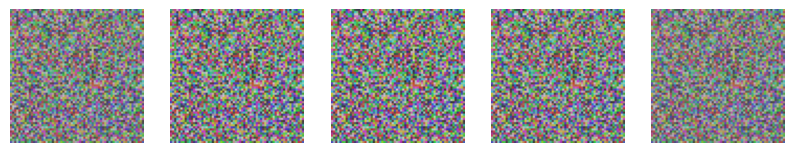

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.7774600982666, D Loss Fake: 16.790212631225586, G Loss: [array(16.790213, dtype=float32), array(16.790213, dtype=float32), array(0.04350649, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

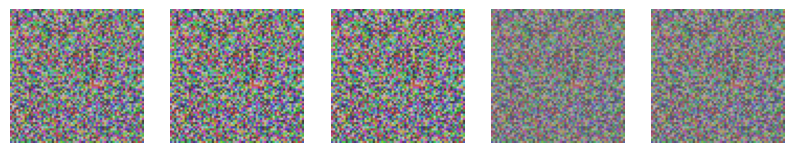

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.779953002929688, D Loss Fake: 16.791778564453125, G Loss: [array(16.791779, dtype=float32), array(16.791779, dtype=float32), array(0.04345006, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

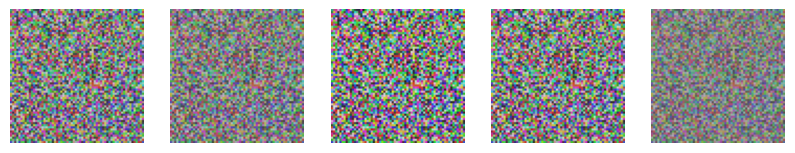

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.781496047973633, D Loss Fake: 16.794466018676758, G Loss: [array(16.794466, dtype=float32), array(16.794466, dtype=float32), array(0.04339378, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

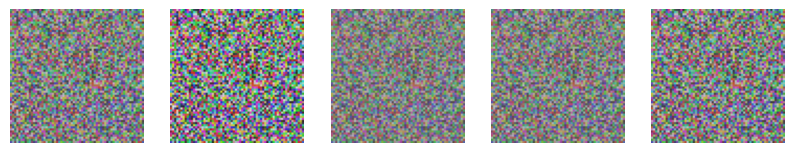

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Epoch 2/10, D Loss Real: 16.784242630004883, D Loss Fake: 16.793411254882812, G Loss: [array(16.793411, dtype=float32), array(16.793411, dtype=float32), array(0.04333765, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


<Figure size 640x480 with 0 Axes>

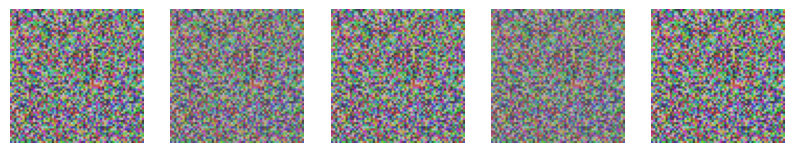

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Epoch 2/10, D Loss Real: 16.78312873840332, D Loss Fake: 16.794208526611328, G Loss: [array(16.794209, dtype=float32), array(16.794209, dtype=float32), array(0.04328165, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


<Figure size 640x480 with 0 Axes>

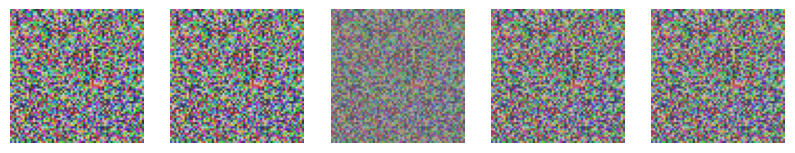

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Epoch 2/10, D Loss Real: 16.78397560119629, D Loss Fake: 16.795551300048828, G Loss: [array(16.795551, dtype=float32), array(16.795551, dtype=float32), array(0.04322581, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

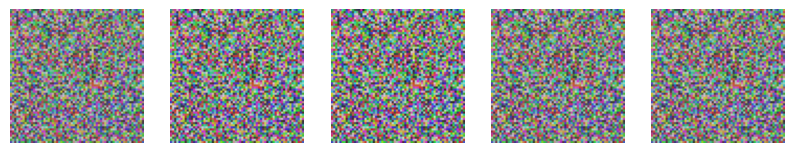

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.785289764404297, D Loss Fake: 16.79509925842285, G Loss: [array(16.7951, dtype=float32), array(16.7951, dtype=float32), array(0.0431701, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

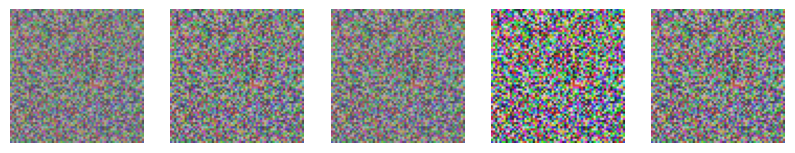

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Epoch 2/10, D Loss Real: 16.784862518310547, D Loss Fake: 16.79631233215332, G Loss: [array(16.796312, dtype=float32), array(16.796312, dtype=float32), array(0.04311454, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


<Figure size 640x480 with 0 Axes>

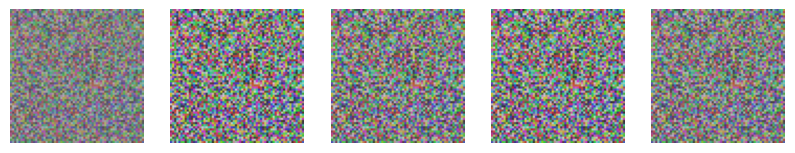

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.786088943481445, D Loss Fake: 16.796667098999023, G Loss: [array(16.796667, dtype=float32), array(16.796667, dtype=float32), array(0.04305913, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

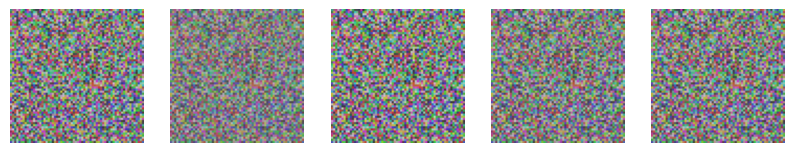

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.78650665283203, D Loss Fake: 16.79694175720215, G Loss: [array(16.796942, dtype=float32), array(16.796942, dtype=float32), array(0.04300385, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

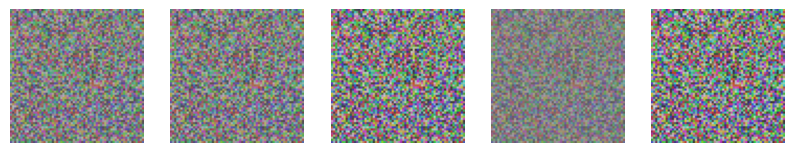

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.78675079345703, D Loss Fake: 16.796180725097656, G Loss: [array(16.79618, dtype=float32), array(16.79618, dtype=float32), array(0.04310897, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

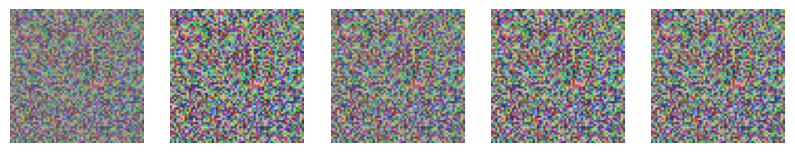

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Epoch 2/10, D Loss Real: 16.78602409362793, D Loss Fake: 16.79725456237793, G Loss: [array(16.797255, dtype=float32), array(16.797255, dtype=float32), array(0.0431338, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

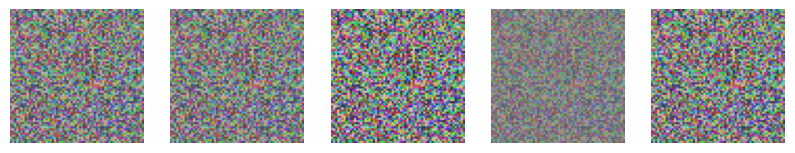

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.78704261779785, D Loss Fake: 16.798198699951172, G Loss: [array(16.798199, dtype=float32), array(16.798199, dtype=float32), array(0.04315857, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

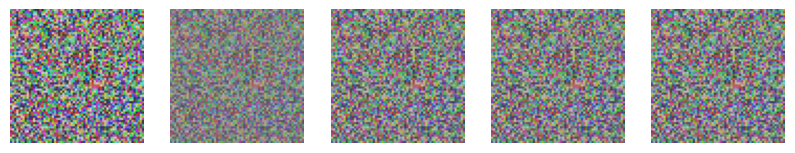

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.788042068481445, D Loss Fake: 16.797929763793945, G Loss: [array(16.79793, dtype=float32), array(16.79793, dtype=float32), array(0.04318327, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

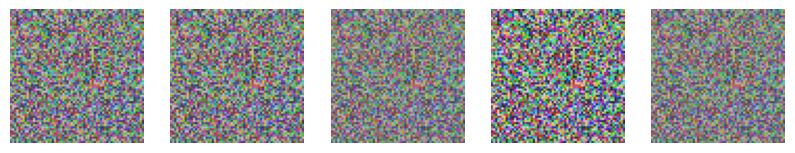

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.78782844543457, D Loss Fake: 16.798799514770508, G Loss: [array(16.7988, dtype=float32), array(16.7988, dtype=float32), array(0.04312819, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

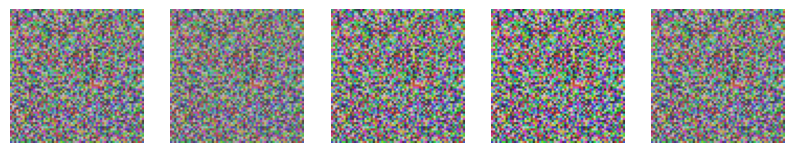

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.788782119750977, D Loss Fake: 16.79709815979004, G Loss: [array(16.797098, dtype=float32), array(16.797098, dtype=float32), array(0.04307325, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

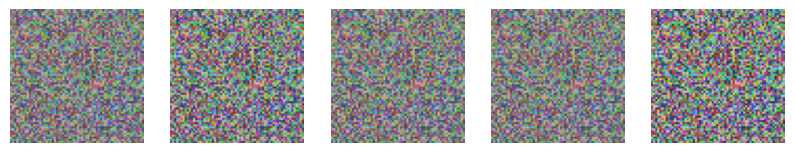

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.78704261779785, D Loss Fake: 16.797855377197266, G Loss: [array(16.797855, dtype=float32), array(16.797855, dtype=float32), array(0.04301845, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


<Figure size 640x480 with 0 Axes>

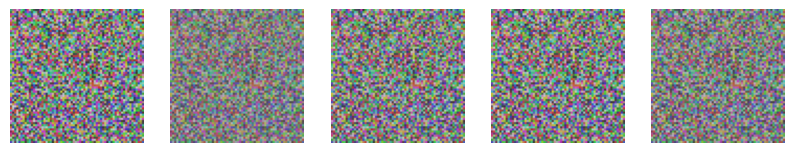

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.78781509399414, D Loss Fake: 16.79768180847168, G Loss: [array(16.797682, dtype=float32), array(16.797682, dtype=float32), array(0.04296379, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

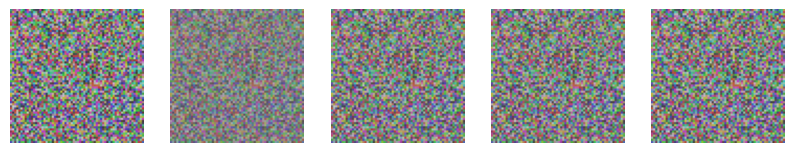

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 2/10, D Loss Real: 16.78765106201172, D Loss Fake: 16.799894332885742, G Loss: [array(16.799894, dtype=float32), array(16.799894, dtype=float32), array(0.04298858, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

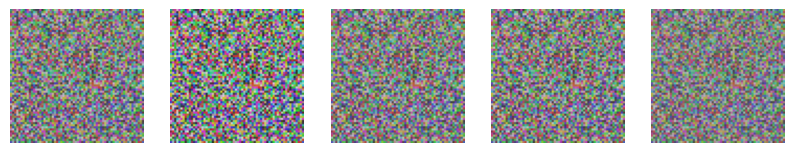

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.789825439453125, D Loss Fake: 16.79810333251953, G Loss: [array(16.798103, dtype=float32), array(16.798103, dtype=float32), array(0.04293409, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


<Figure size 640x480 with 0 Axes>

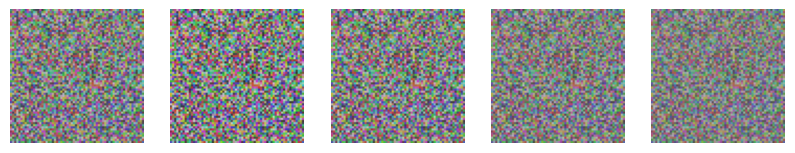

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Epoch 2/10, D Loss Real: 16.788116455078125, D Loss Fake: 16.80044937133789, G Loss: [array(16.80045, dtype=float32), array(16.80045, dtype=float32), array(0.04287975, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

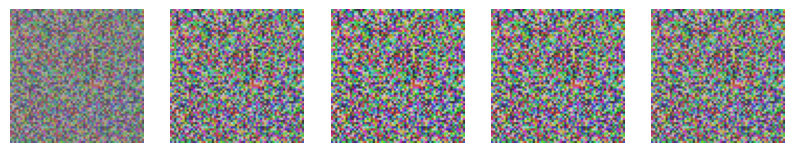

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Epoch 2/10, D Loss Real: 16.790451049804688, D Loss Fake: 16.800718307495117, G Loss: [array(16.800718, dtype=float32), array(16.800718, dtype=float32), array(0.04290455, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

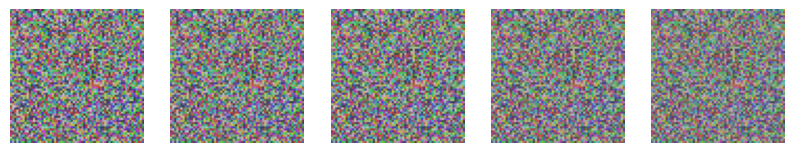

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.7906494140625, D Loss Fake: 16.799814224243164, G Loss: [array(16.799814, dtype=float32), array(16.799814, dtype=float32), array(0.04292929, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<Figure size 640x480 with 0 Axes>

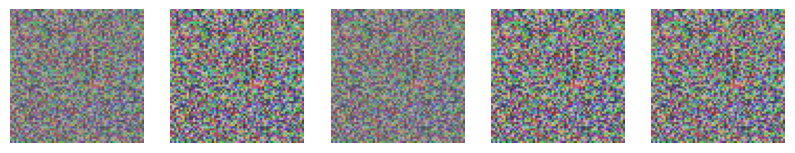

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 2/10, D Loss Real: 16.789813995361328, D Loss Fake: 16.79976463317871, G Loss: [array(16.799765, dtype=float32), array(16.799765, dtype=float32), array(0.04295397, dtype=float32)]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


<Figure size 640x480 with 0 Axes>

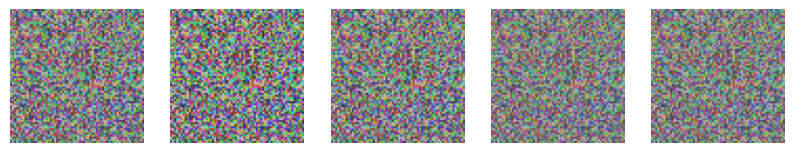

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


KeyboardInterrupt: 

<Figure size 640x480 with 0 Axes>

In [8]:
def generate_and_show_images(epoch, generator, num_images=5):
    noise = np.random.randn(num_images, 100)  
    generated_images = generator.predict(noise) 

    # Normalize images from [-1,1] to [0,1] for display
    generated_images = (generated_images + 1) / 2.0  

    fig, axes = plt.subplots(1, num_images, figsize=(10, 10))
    for i in range(num_images):
        axes[i].imshow(generated_images[i])  
        axes[i].axis("off")  

    plt.show()  
    plt.savefig(f"generated_epoch_{epoch}.png")
# Function to train the GAN
def train_gan(epochs, batch_size, dataset):

    for epoch in range(epochs):
        # Train the discriminator
        for real_images in dataset:  
            current_batch_size=real_images.shape[0]
            if current_batch_size<batch_size:
                break
            noise = np.random.randn(batch_size, 100)  
            fake_images = generator.predict(noise)  

            # Labels for real and fake images
            real_labels = np.ones((batch_size, 1))  
            fake_labels = np.zeros((batch_size, 1)) 

            # Train on real images
            d_loss_real = discriminator.train_on_batch(real_images, real_labels)

            # Train on fake images
            d_loss_fake = discriminator.train_on_batch(fake_images, fake_labels)

            # Train the generator (via the GAN)
            noise = np.random.randn(batch_size, 100)  
            valid_labels = np.ones((batch_size, 1))  
            g_loss = gan.train_on_batch(noise, valid_labels)

            # Print the progress
            print(f"Epoch {epoch+1}/{epochs}, D Loss Real: {d_loss_real[0]}, D Loss Fake: {d_loss_fake[0]}, G Loss: {g_loss}")
                #to show images
            if (epoch + 1) % 2 == 0:
                   generate_and_show_images(epoch + 1, generator)
# Train the GAN with a defined number of epochs
epochs = 10
batch_size =8
train_gan(epochs, batch_size, train_dataset)